### Installing the libraries

In [2]:
%pip install dill
%pip install path
%pip install route 

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


### Importing the libraries

In [3]:
#Setting up paths

#Import dill library to save variables generated
import platform
import sys
import dill
import pickle
import path
import os

if platform.system() == "Windows":
    sys.path.append(rf'D:\Tensor Based ML for Neuro Imaging\INSPIRE_CAHBHIR\Python Scripts\LSR-Tensor-Ridge-Regression\Closed_Form_Solver\Code Files')
    sys.path.append(rf'D:\Tensor Based ML for Neuro Imaging\INSPIRE_CAHBHIR\Python Scripts\LSR-Tensor-Ridge-Regression\Closed_Form_Solver\Experimental Results\Tensor_Method\Closed Form')
elif platform.system() == "Darwin":
    sys.path.append()
    sys.path.append()
    
#Import Standard Data Analysis Libraries
import datetime
import numpy as np
import pandas as pd
import re
import scipy.io

#plotting functions
import matplotlib.pyplot as plt
import seaborn as sns



### Loading Data

In [4]:
#loading file path
if platform.system() == "Windows":
    pkl_file = rf"D:\Tensor Based ML for Neuro Imaging\INSPIRE_CAHBHIR\Python Scripts\LSR-Tensor-Ridge-Regression\Closed_Form_Solver\Experimental Results\Tensor_Method\Closed Form\HCP_lambdas_[176, 178, 180, 182, 184]_sep_5_tucker_[4 4].pkl"
elif platform.system() == "Darwin":
    pkl_file = f"/content/gdrive/MyDrive/The Pipeline/Experimental Results/16-16-4-4/Tensor Results/ExecutionTime_2024-03-11 21:17:28, n_train_300, n_test_100, p1_16, p2_16, d1_4, d2_4, S_1 _Dataset.pkl"

file= open(pkl_file, 'rb')
data = pickle.load(file)
file.close()

X_train = data[0]
Y_train = data[1]
X_test  = data[2]
Y_test  = data[3]
lambda1 = data[4]
validation_normalized_estimation_error = data[5]
validation_nmse_losses = data[6]
validation_correlations = data[7]
validation_R2_scores = data[8]
objective_function_information = data[9]
gradient_information = data[10]
test_normalized_estimation_error = data[11]
test_nmse_loss = data[12]
test_R2_loss = data[13]
test_correlation = data[14]
objective_function_values = data[15]
gradient_values = data[16]
iterate_level_values = data[17]

### Objective Function Values 

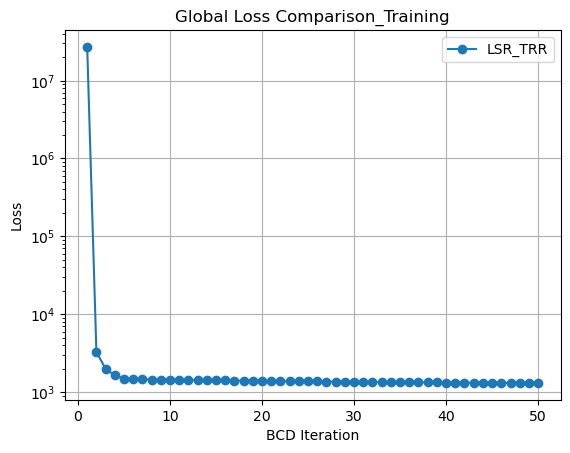

Final Objective Function Value CLOSED: [1315.38636902]


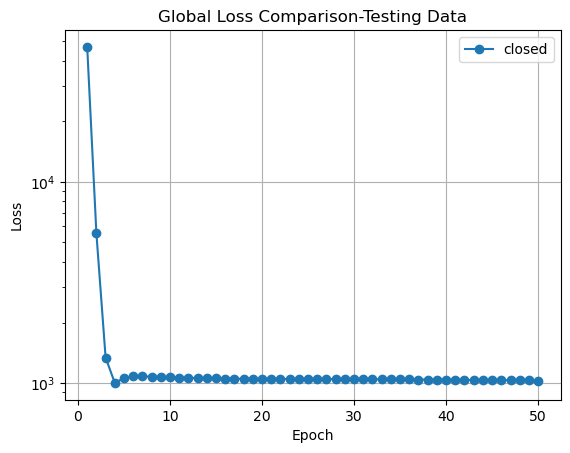

Final Objective Function Value CLOSED: 1030.1095128588327


In [5]:
# Training 

training_objective_function_values = objective_function_values[:,0,2].reshape(-1,1)

plt.figure()
# Plotting closed form solver
plt.plot(range(1, len(training_objective_function_values) + 1), training_objective_function_values, label='LSR_TRR',marker = 'o')

# Setting the title and labels
plt.title('Global Loss Comparison_Training')
plt.yscale('log')
plt.xlabel('BCD Iteration')
plt.ylabel('Loss')
plt.yscale('log')
plt.grid(True)
# Adding a legend to distinguish the two plots
plt.legend()
# Display the plot
plt.show()

print('Final Objective Function Value CLOSED:',training_objective_function_values[-1])


# Testing 
def objective_function_tensor_sep(y: np.ndarray, X: np.ndarray, iterate_level_values, alpha,max_iteration,b = None):
    
    from optimization import inner_product
    
    function_value = []
    
    for iter in range(max_iteration):
        
        B = iterate_level_values[1][-1][iter]
        B11 = iterate_level_values[0][0][iter]
        B12 = iterate_level_values[0][1][iter]
        B21 = iterate_level_values[1][0][iter]
        B22 = iterate_level_values[1][1][iter]
        G = iterate_level_values[0][-1][iter]  

        I = inner_product(X, B).flatten()
        y = y.flatten()
        B = B.flatten()
        
        regularizer = 0
        
        #developing the separable regularizing term
        
        # Calculate the Frobenius norm of each matrix
        
        norm_B11 = np.linalg.norm(B11, 'fro')
        norm_B12 = np.linalg.norm(B12, 'fro')
        norm_B21 = np.linalg.norm(B21, 'fro')
        norm_B22 = np.linalg.norm(B22, 'fro')
        norm_G = np.linalg.norm(G, 'fro')
        

        # Calculate the sum of Frobenius norms
        regularizer = norm_B11 + norm_B12 + norm_B21 + norm_B22 + norm_G
        if b is not None:
            b = b.flatten()
            function = (np.linalg.norm(y - I -b) ** 2) + (alpha * regularizer)
        else:
            function = (np.linalg.norm(y - I) ** 2) + (alpha * regularizer)
        
        function_value.append(function)
    
    return function_value


#closed_form
closed_test_loss = objective_function_tensor_sep(Y_test,X_test,iterate_level_values,lambda1,50,b = None)

plt.figure()

# Plotting SGD
plt.plot(range(1, len(closed_test_loss) + 1),closed_test_loss, label='closed',marker = 'o')

# Setting the title and labels
plt.title('Global Loss Comparison-Testing Data')
plt.yscale('log')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.grid(True)

# Adding a legend to distinguish the two plots
plt.legend()

# Display the plot
plt.show()

print('Final Objective Function Value CLOSED:',closed_test_loss[-1])



### Iterate Difference 

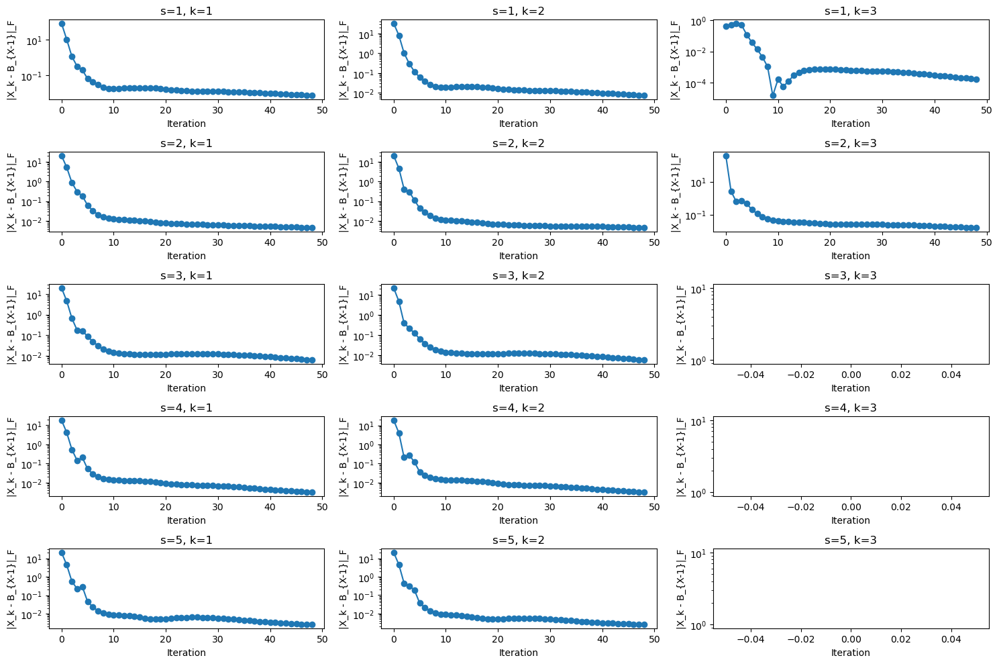

In [36]:
# factor matrix

def iterate_diff(iterate_level_values,s,k,max_iter):
    B = iterate_level_values[s][k]
    iter_diff = []
    for i in range(1,max_iter):
        diff = B[i] - B[i-1]
        norm_diff = np.linalg.norm(diff,'fro')
        iter_diff.append(norm_diff)
    return iter_diff

import numpy as np

all_diff_sep = []
for s in range(len(iterate_level_values)):
    all_diff_fac = []
    for k in range(len(iterate_level_values[s])):
        if len(iterate_level_values[s][k][0]) == 0:  # Check if the array is empty
            difference = []
            all_diff_fac.append(difference)
        else:
            difference = iterate_diff(iterate_level_values, s, k, 50) 
            all_diff_fac.append(difference)
    all_diff_sep.append(all_diff_fac)

# Determine the number of rows and columns for subplots
num_rows = len(all_diff_sep)
num_cols = len(all_diff_sep[0]) if num_rows > 0 else 0


# Create subplots
fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 10))

# Iterate through all_diff_sep to plot the differences
for s in range(num_rows):
    for k in range(num_cols):
        ax = axes[s, k] if num_rows > 1 else axes[k]
        ax.plot(all_diff_sep[s][k],marker = 'o')
        ax.set_title(f's={s+1}, k={k+1}')
        ax.set_xlabel('Iteration')
        ax.set_ylabel('|X_k - B_{X-1}|_F')
        ax.set_yscale('log')

# Adjust layout for better readability
plt.tight_layout()
plt.show()




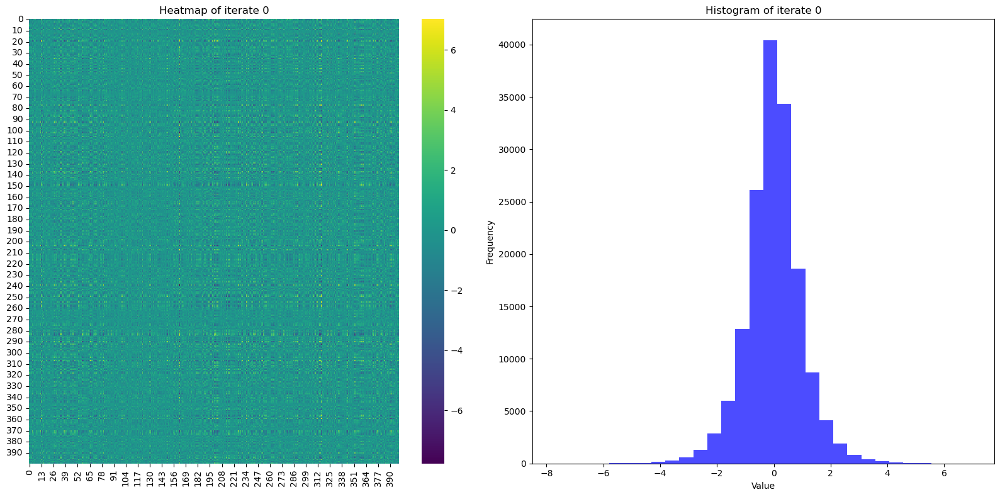

Energy of iterate 0: 105.98897194847491


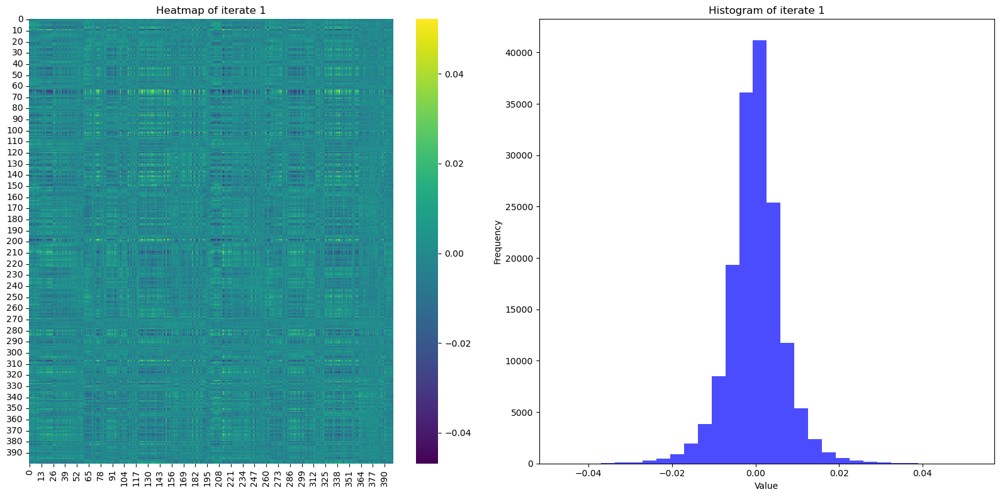

Energy of iterate 1: 2.388068056823973


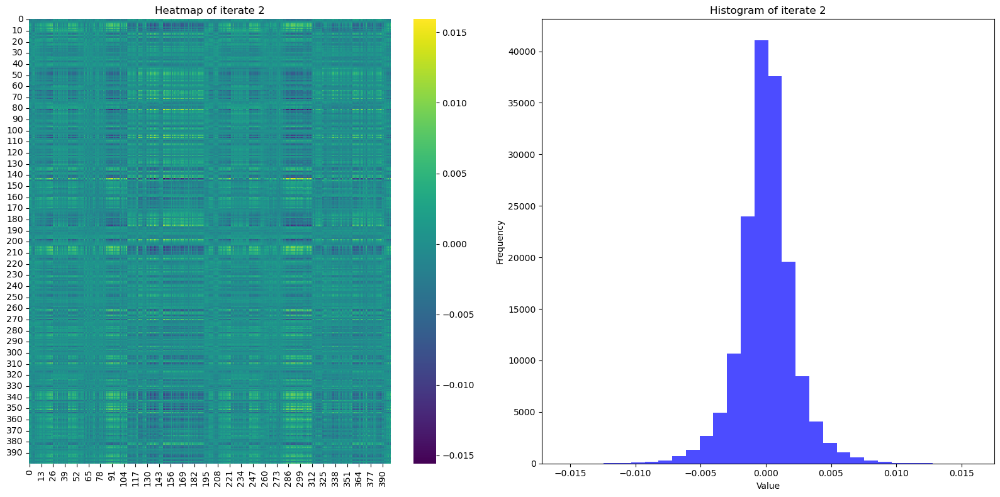

Energy of iterate 2: 0.5288844407998947


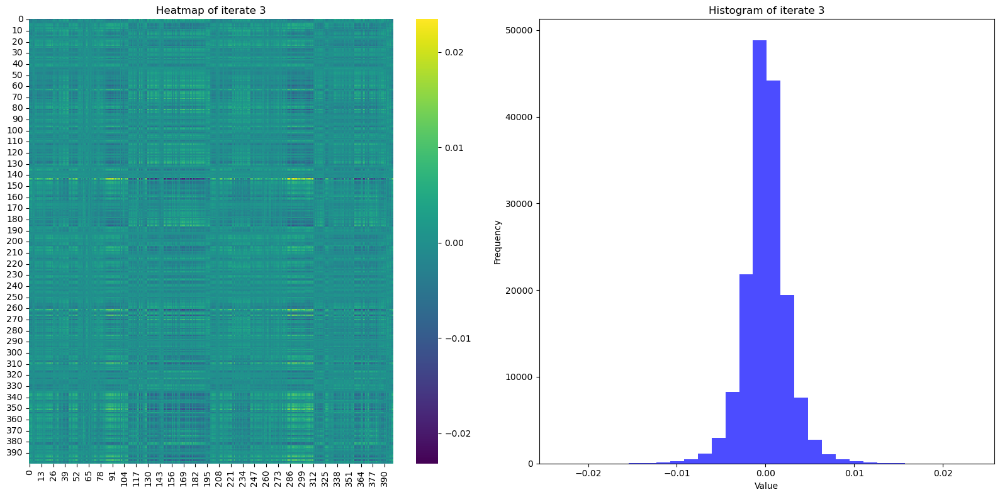

Energy of iterate 3: 0.8538669630522252


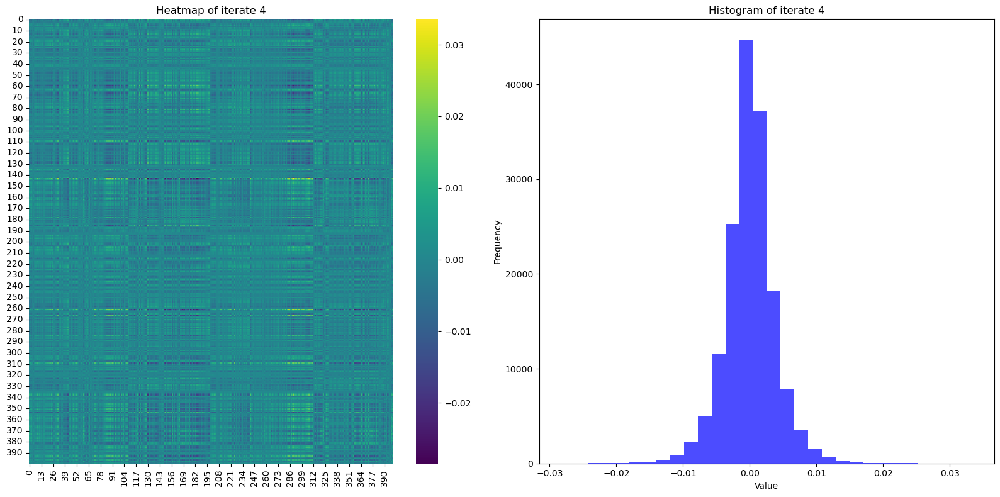

Energy of iterate 4: 1.0100903927472313


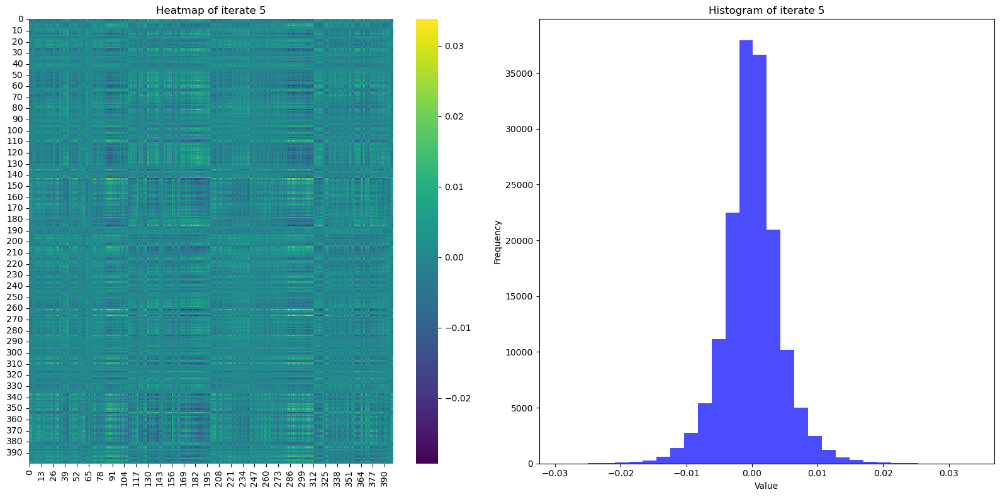

Energy of iterate 5: 0.9963513501245165


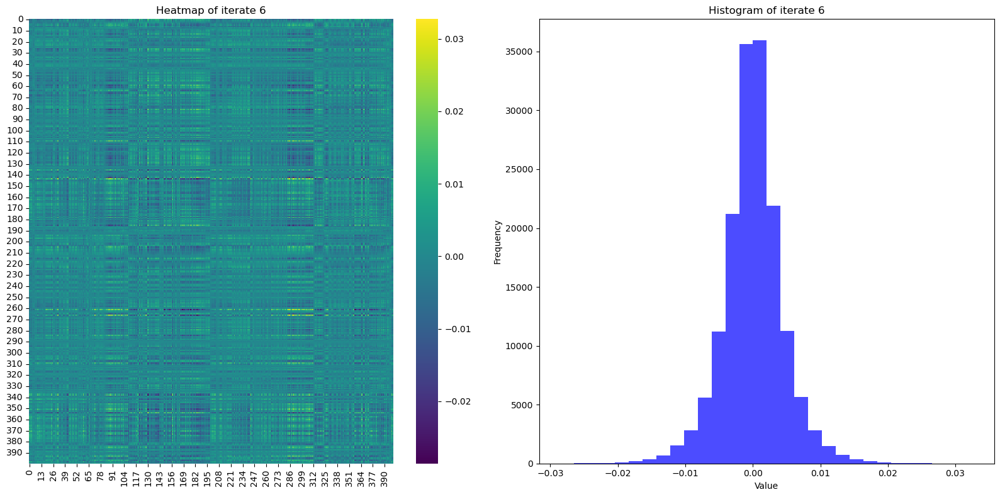

Energy of iterate 6: 0.9982994881230698


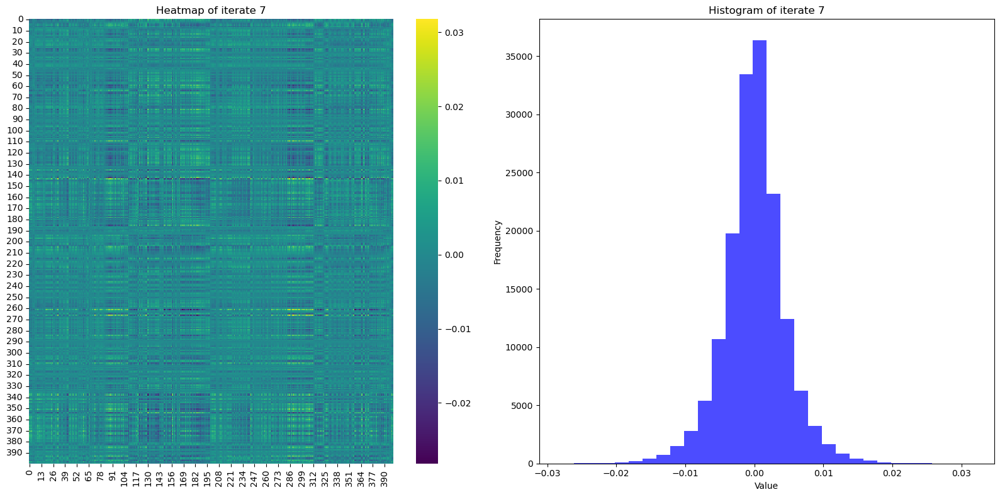

Energy of iterate 7: 1.0040654337497352


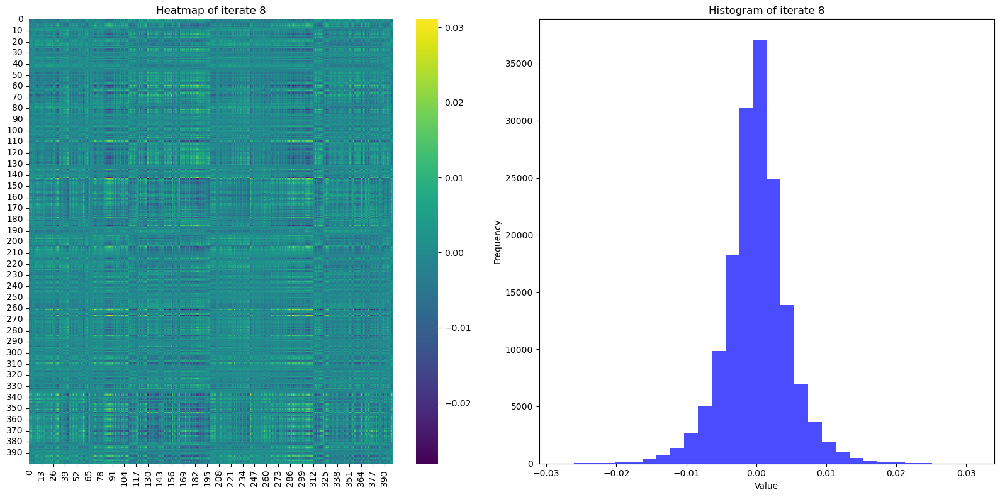

Energy of iterate 8: 1.0142121715074797


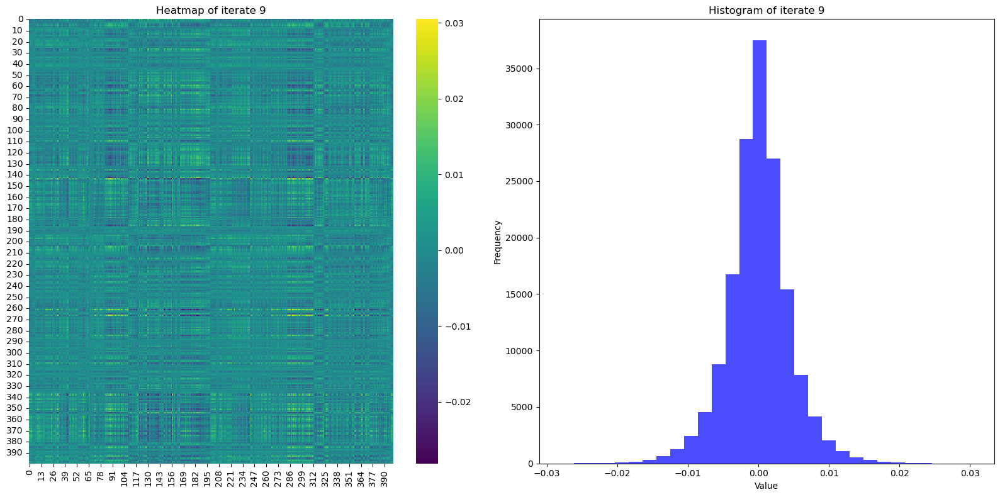

Energy of iterate 9: 1.0271451683330244


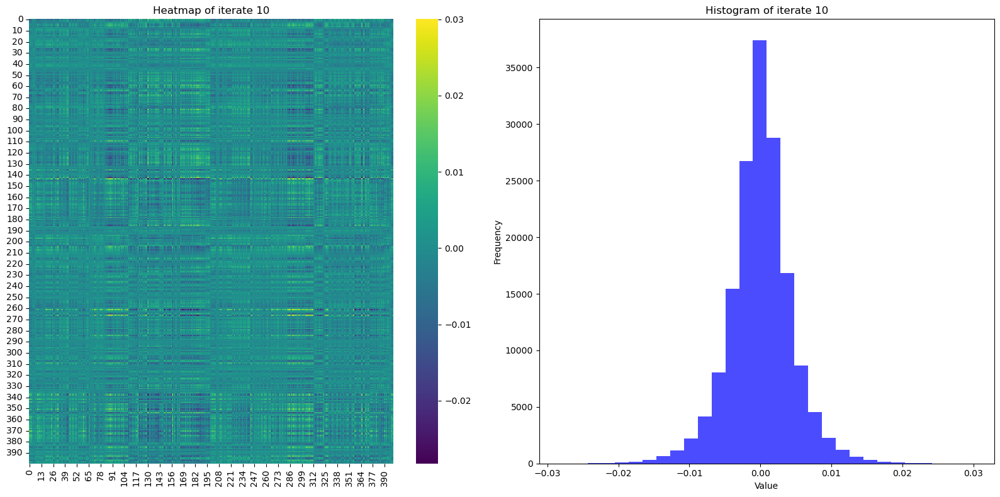

Energy of iterate 10: 1.0415476260900525


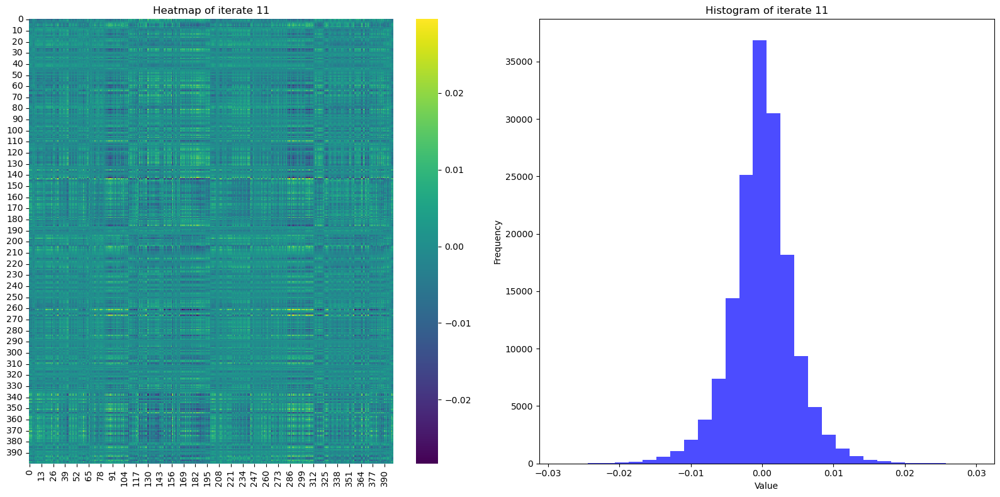

Energy of iterate 11: 1.0566121160127475


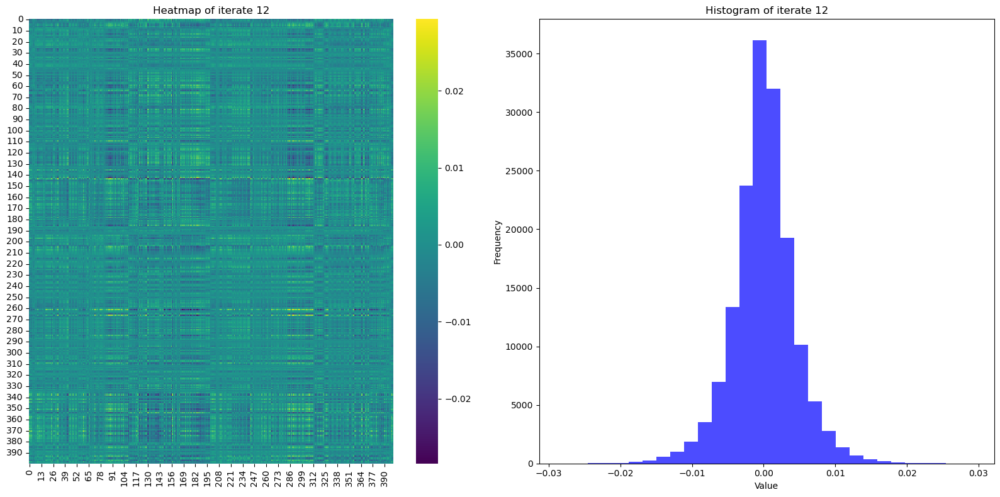

Energy of iterate 12: 1.0719477050141468


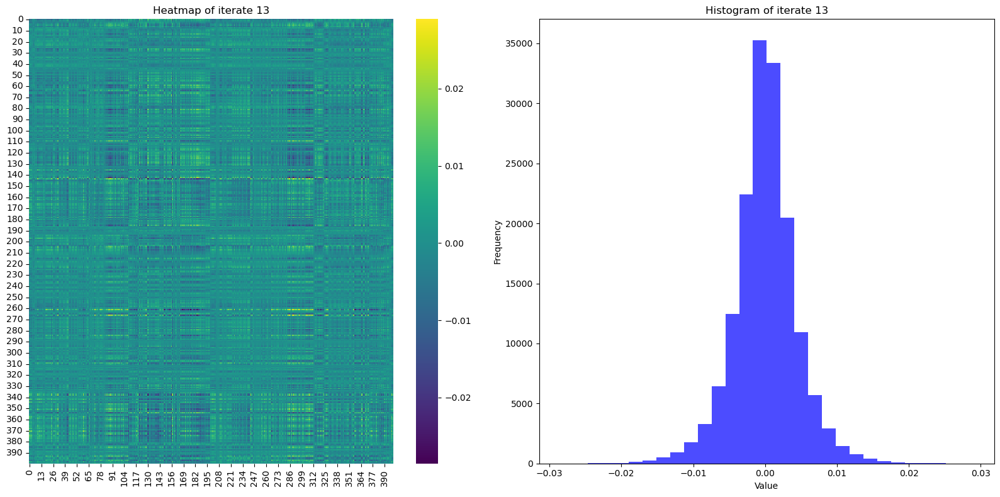

Energy of iterate 13: 1.087499282968789


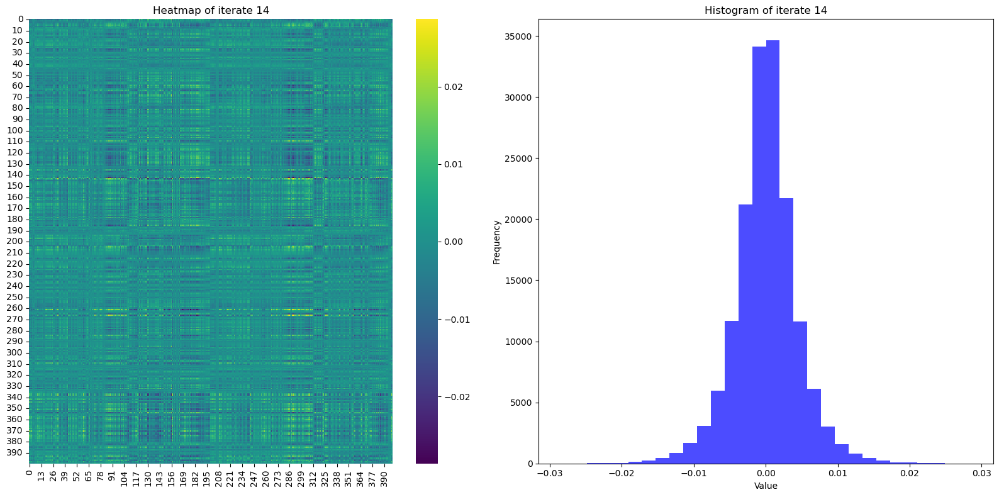

Energy of iterate 14: 1.103468885936179


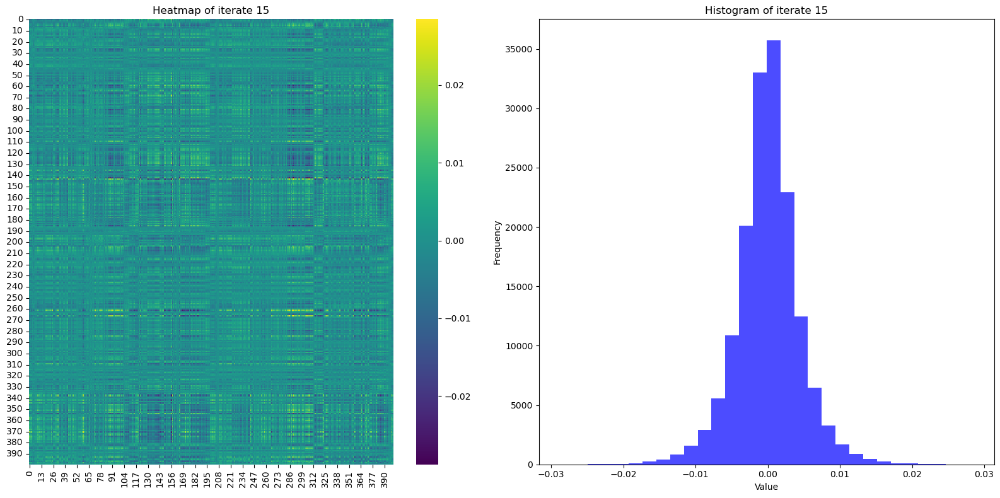

Energy of iterate 15: 1.1202174196863905


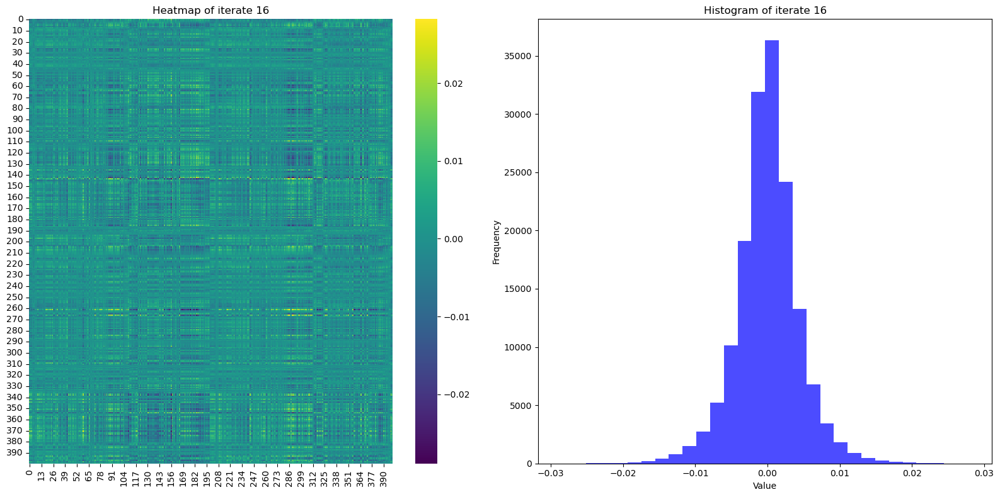

Energy of iterate 16: 1.1381368979765516


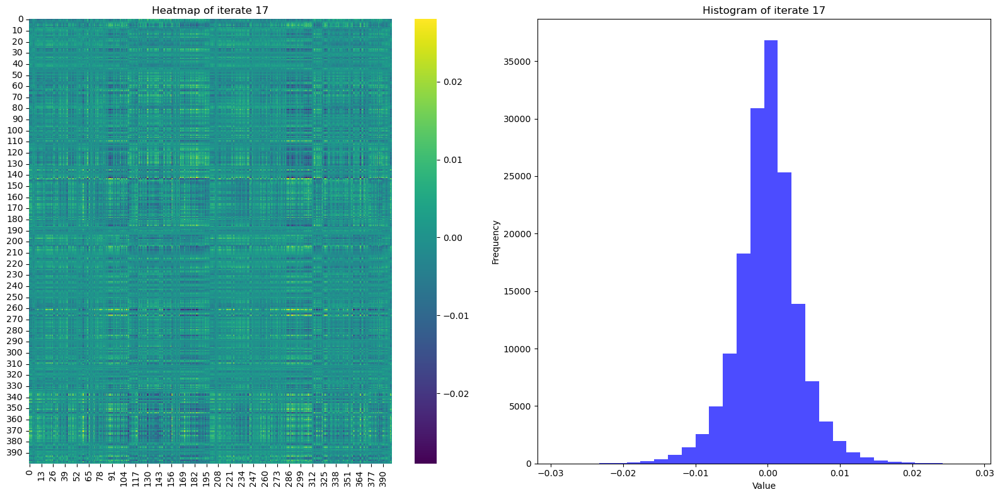

Energy of iterate 17: 1.1575107065360957


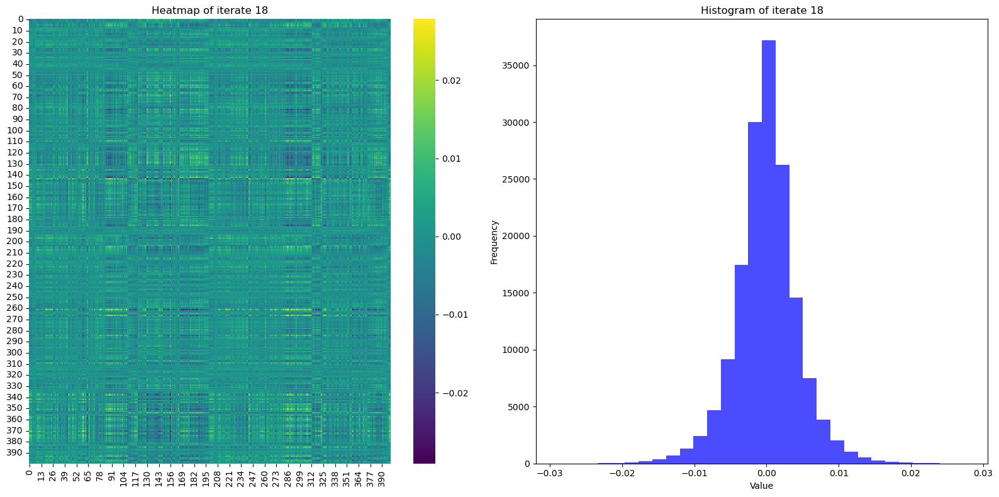

Energy of iterate 18: 1.1784099971811663


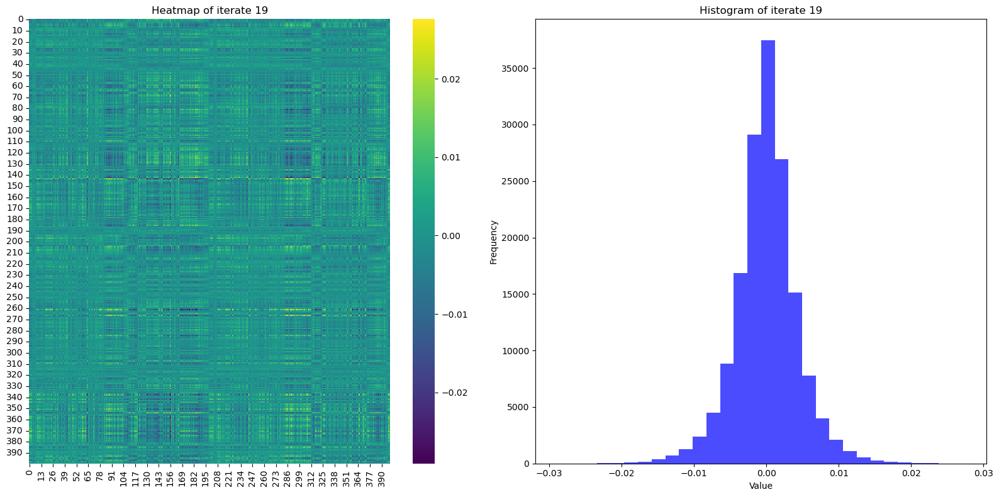

Energy of iterate 19: 1.200670811114061


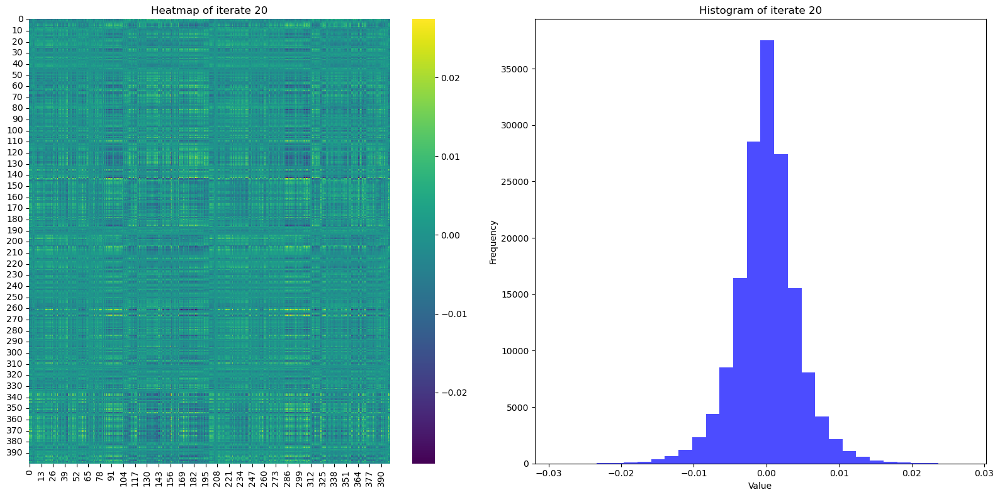

Energy of iterate 20: 1.2239516691684817


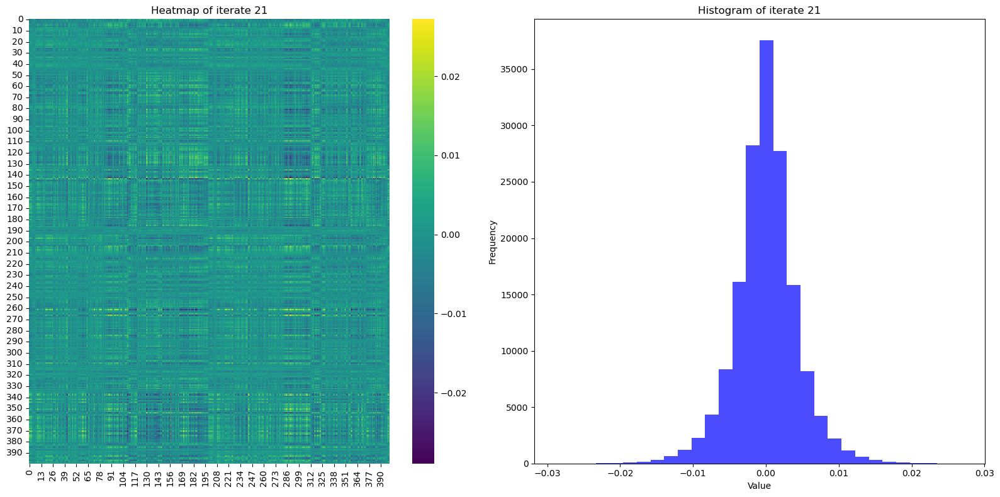

Energy of iterate 21: 1.247828428049646


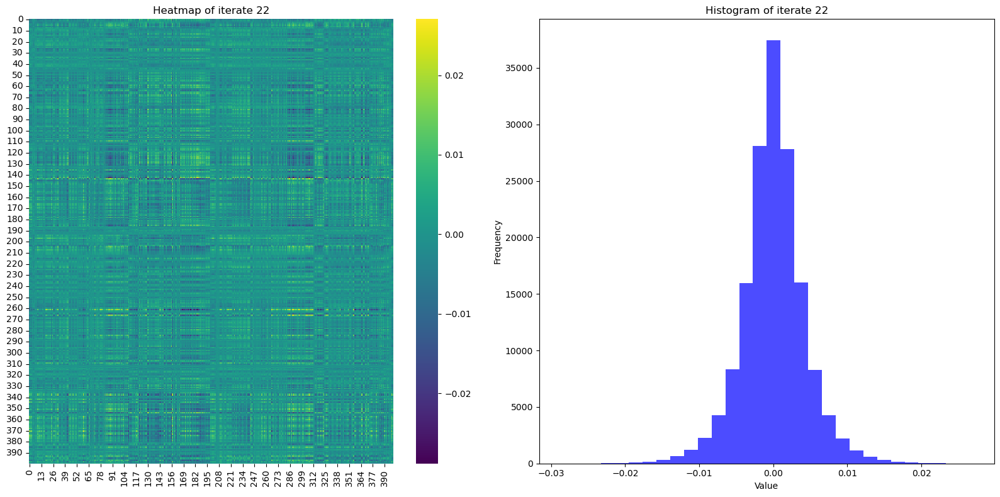

Energy of iterate 22: 1.2718791428899898


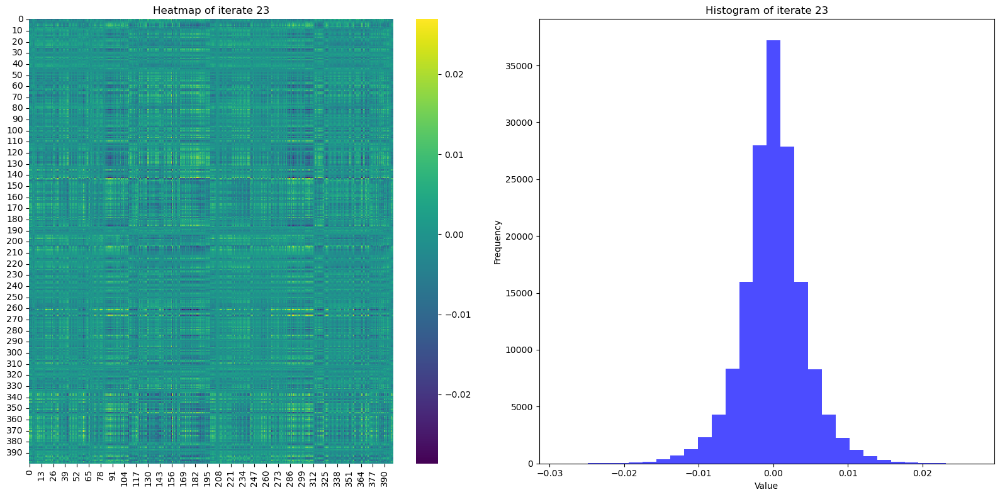

Energy of iterate 23: 1.2957361556672882


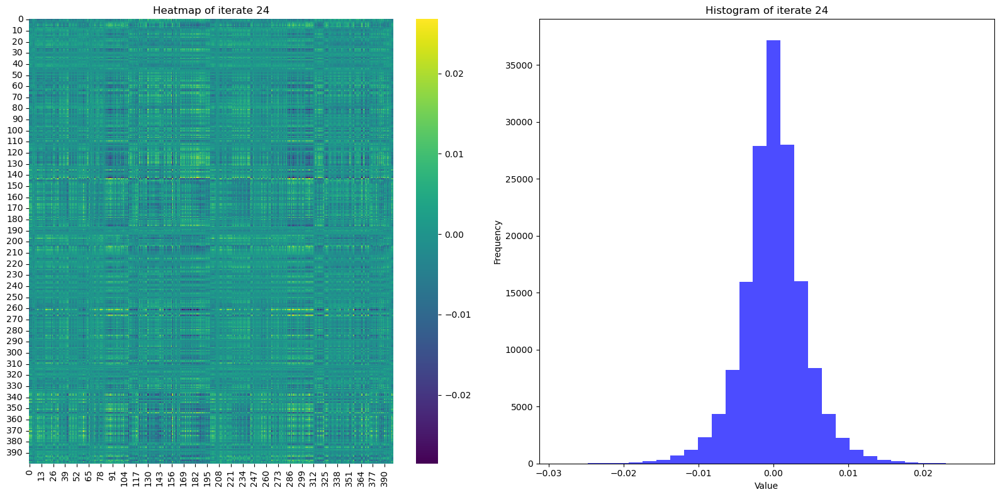

Energy of iterate 24: 1.3191065372770938


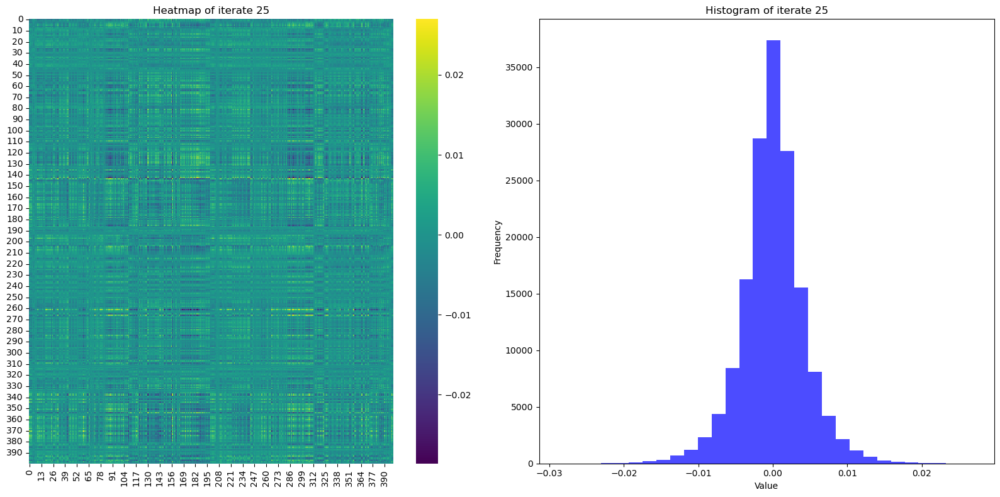

Energy of iterate 25: 1.341772167120942


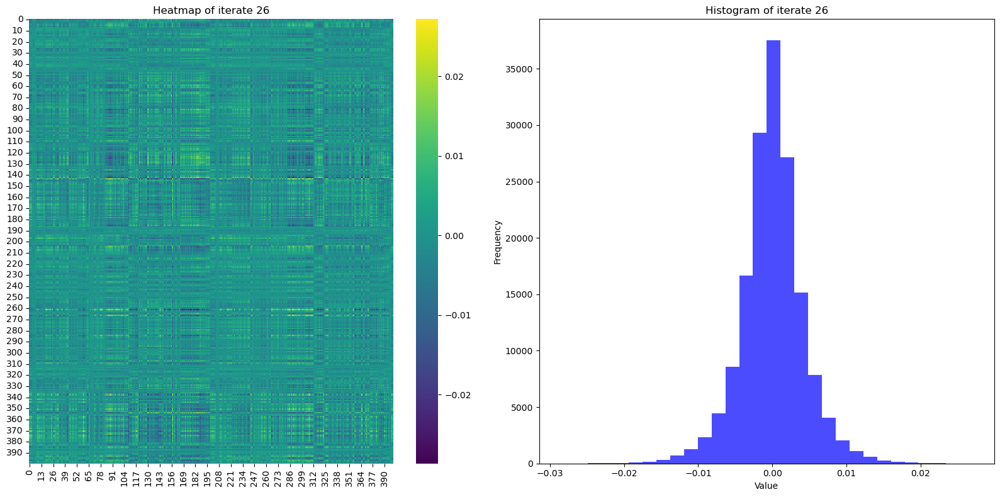

Energy of iterate 26: 1.3635803873802312


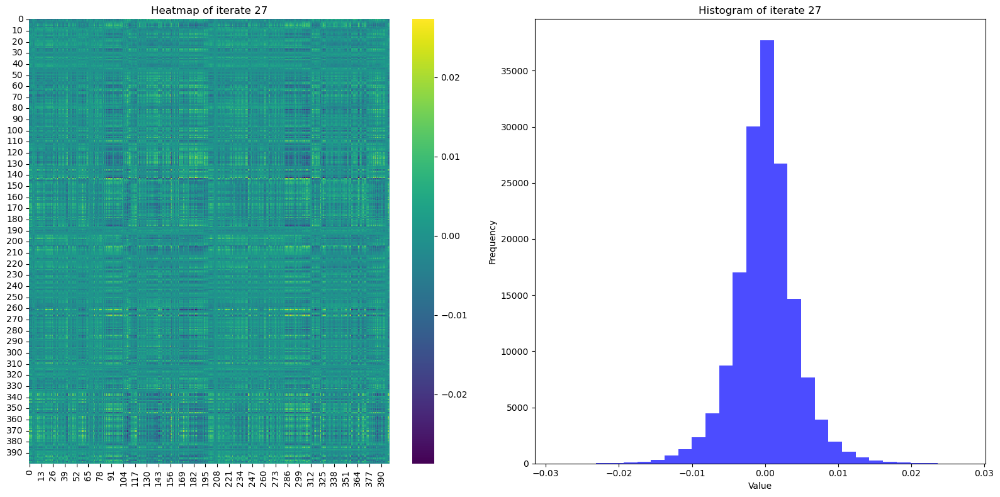

Energy of iterate 27: 1.384432156940262


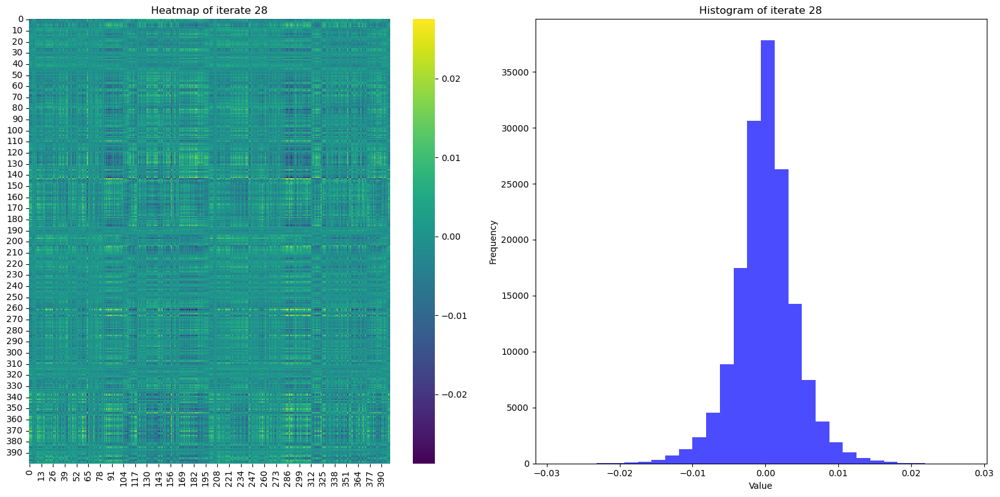

Energy of iterate 28: 1.404270926301411


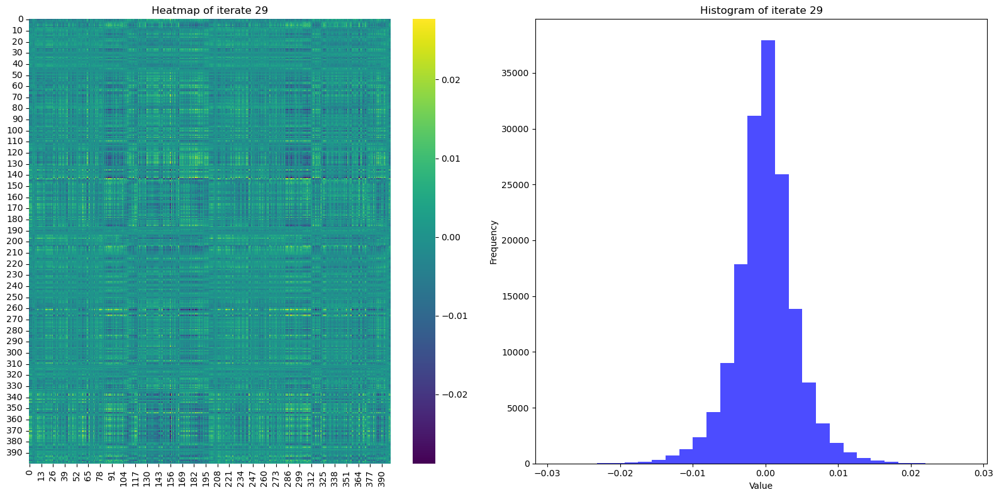

Energy of iterate 29: 1.4230731692408718


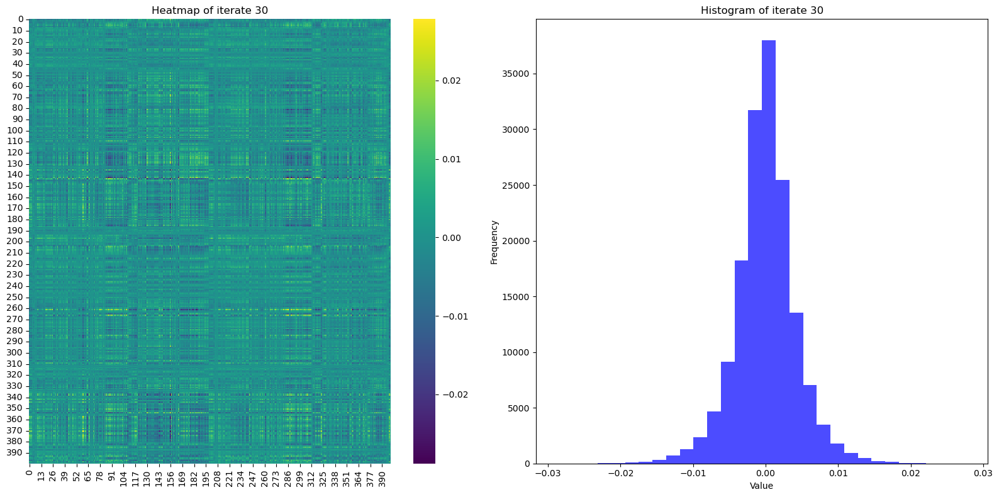

Energy of iterate 30: 1.440840459052479


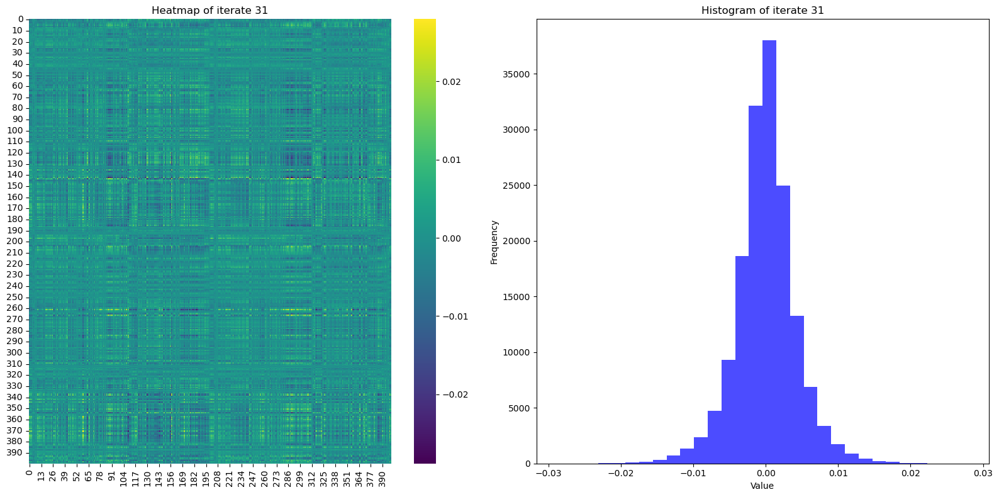

Energy of iterate 31: 1.4575927033546645


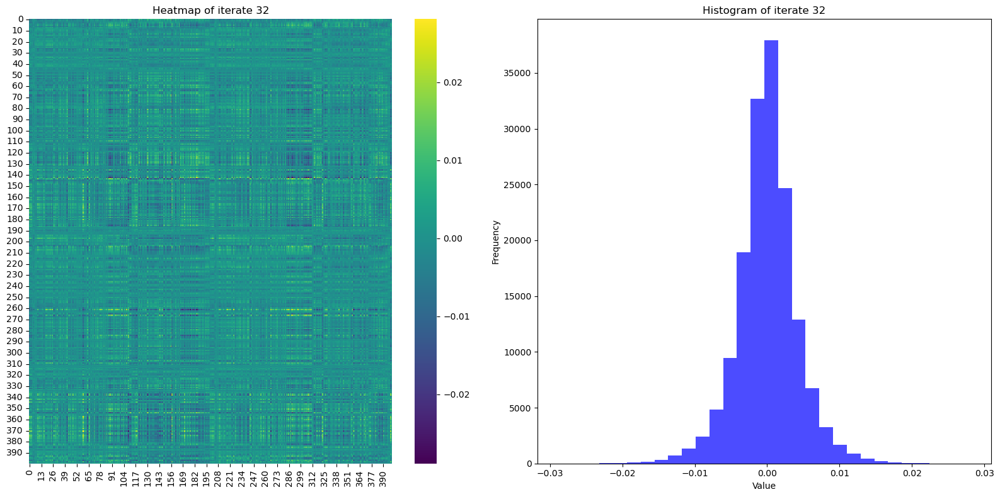

Energy of iterate 32: 1.4733622561602195


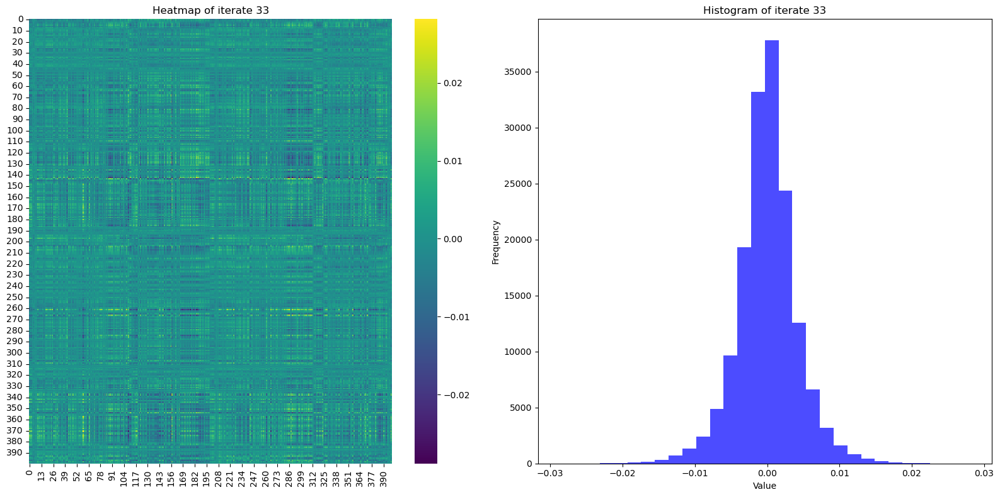

Energy of iterate 33: 1.4881888368925464


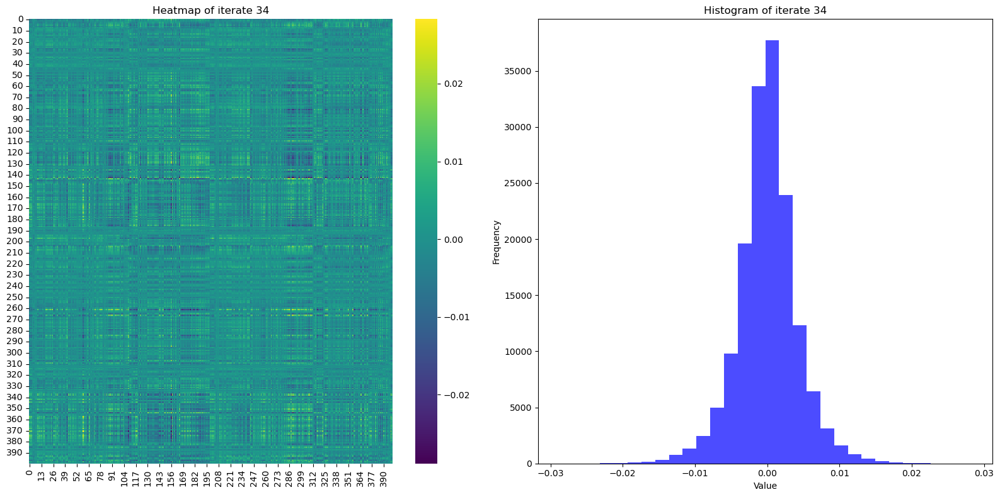

Energy of iterate 34: 1.5021153411337524


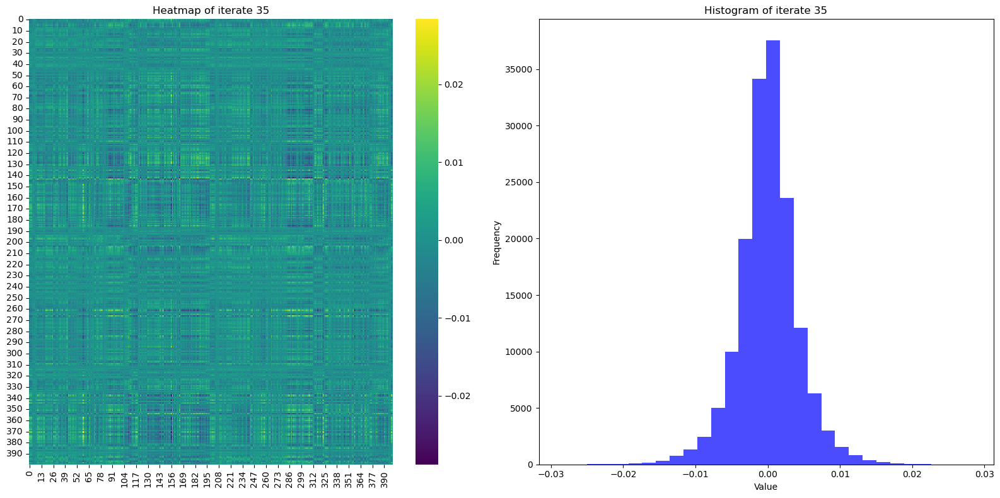

Energy of iterate 35: 1.5151846615704851


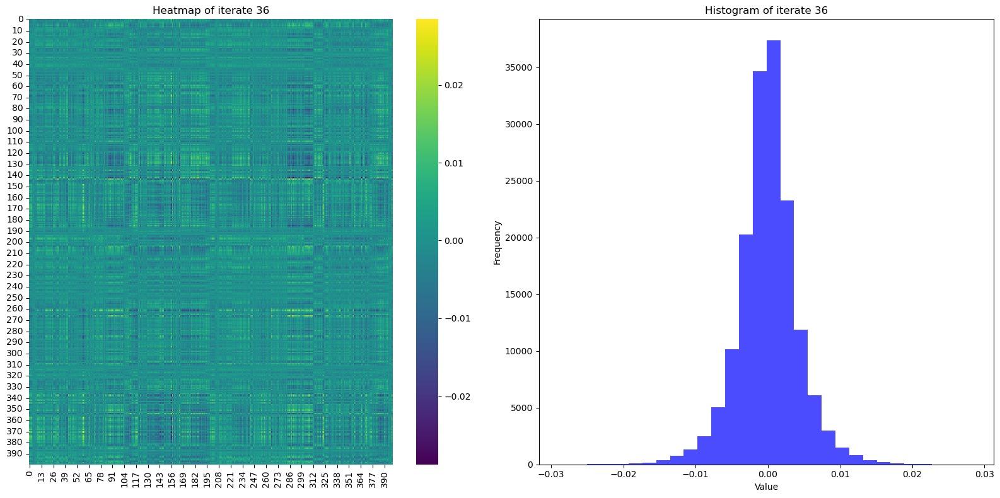

Energy of iterate 36: 1.5274375632711645


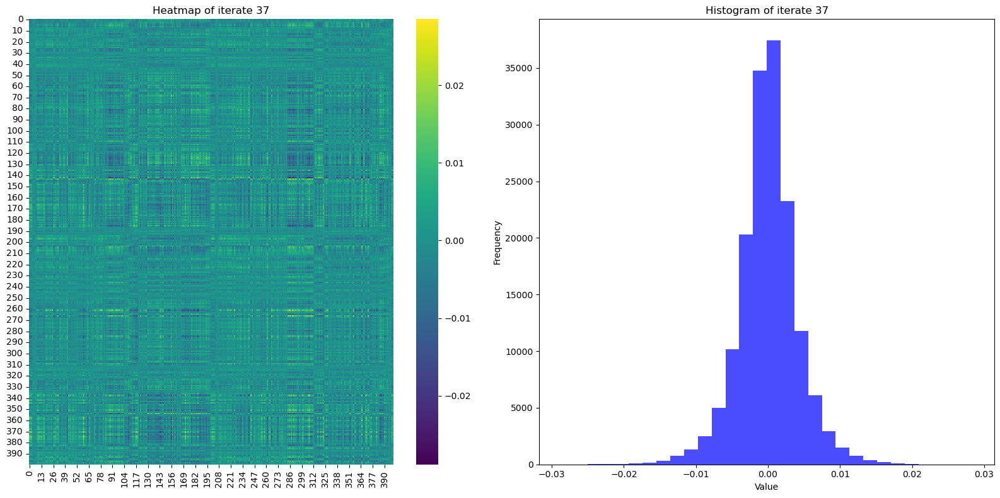

Energy of iterate 37: 1.538911534419363


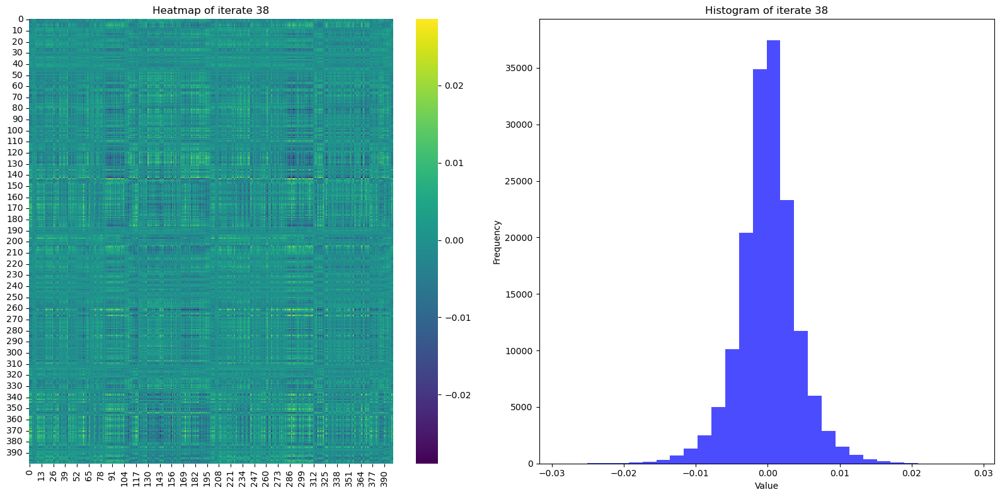

Energy of iterate 38: 1.5496404261635486


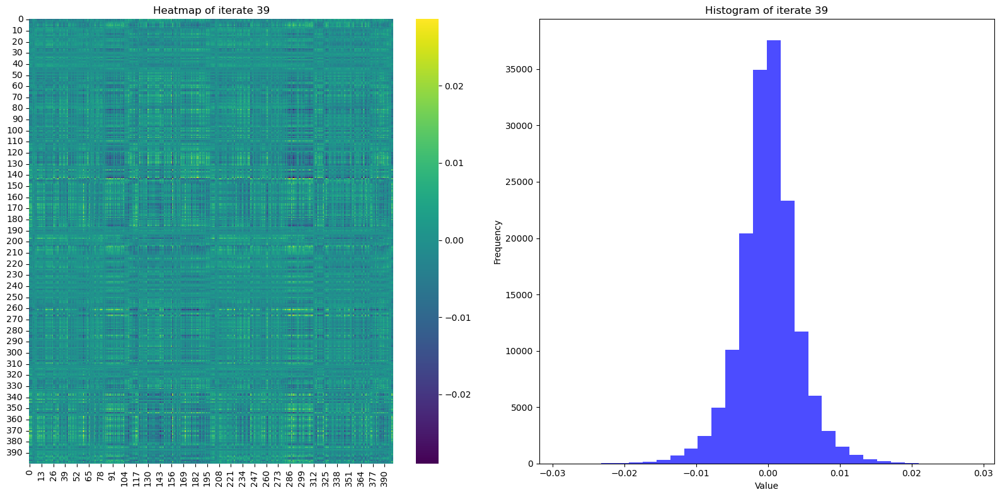

Energy of iterate 39: 1.5596546419102117


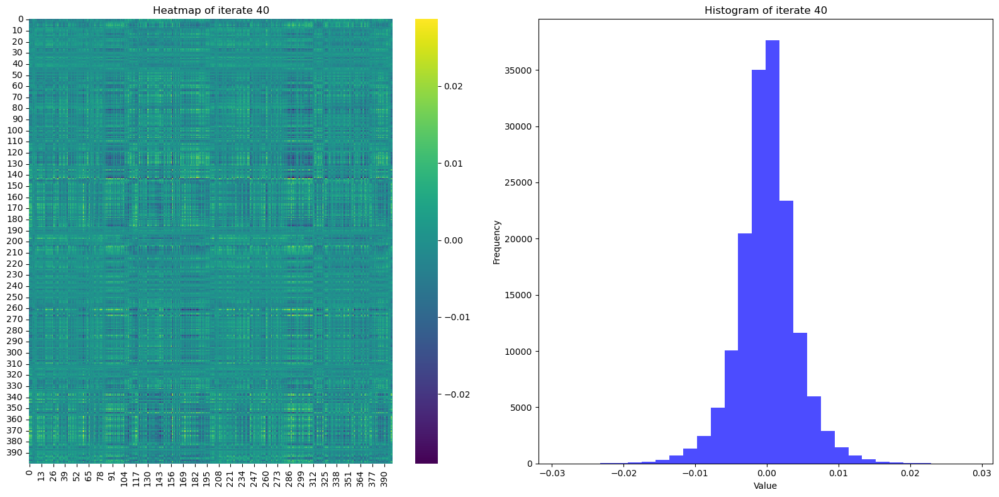

Energy of iterate 40: 1.5689816418690568


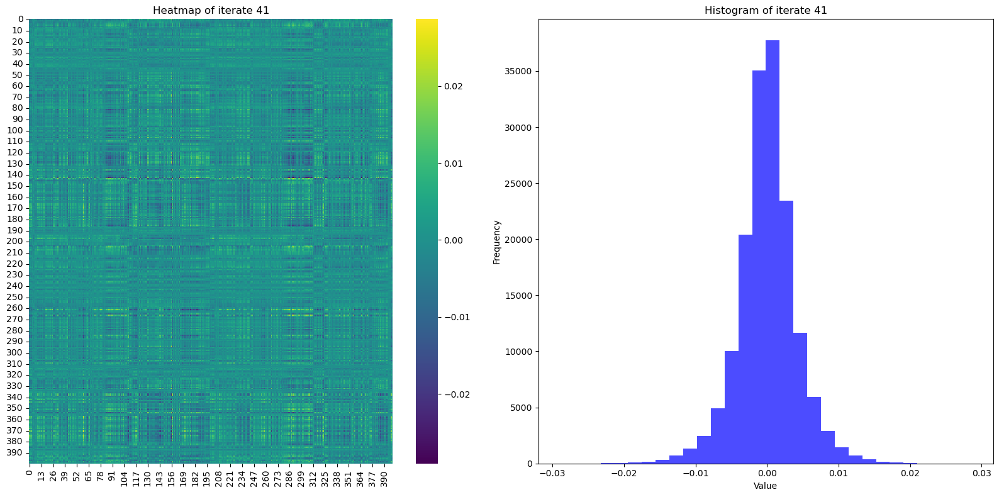

Energy of iterate 41: 1.5776465742483035


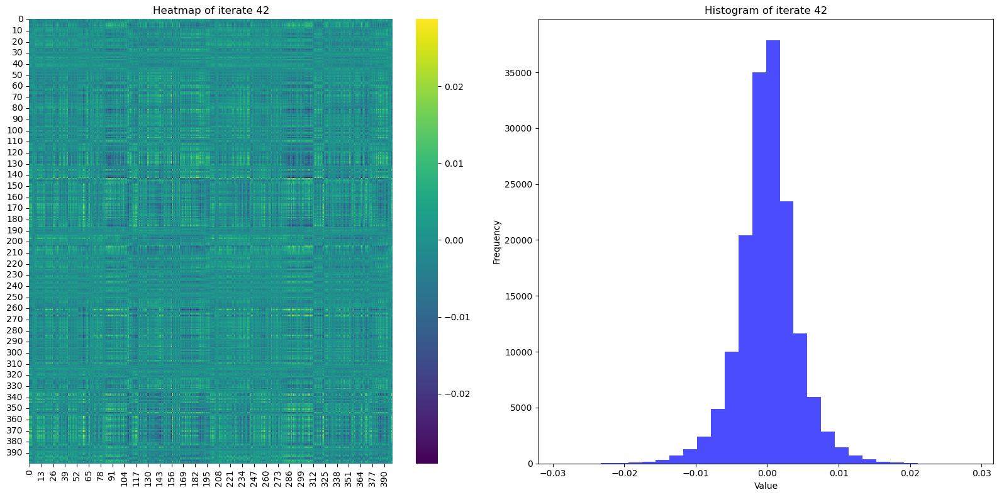

Energy of iterate 42: 1.585672904898505


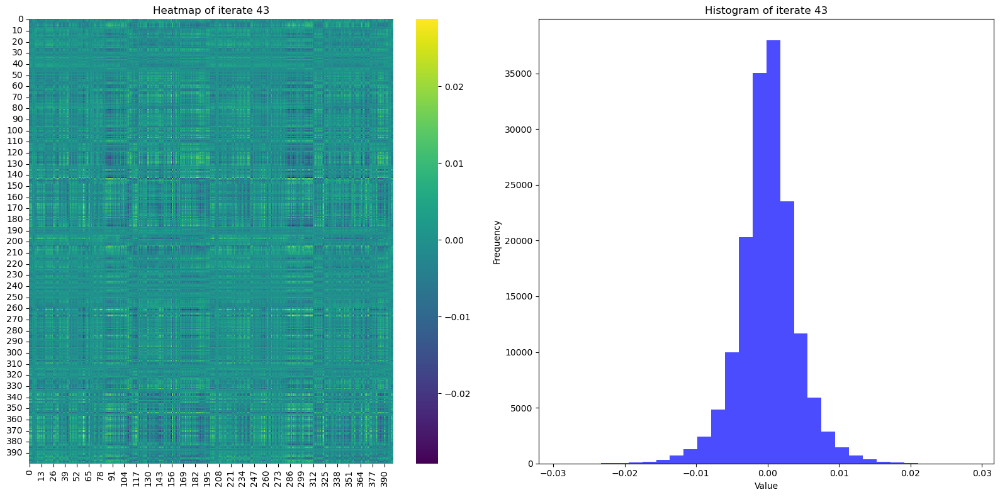

Energy of iterate 43: 1.593082972858875


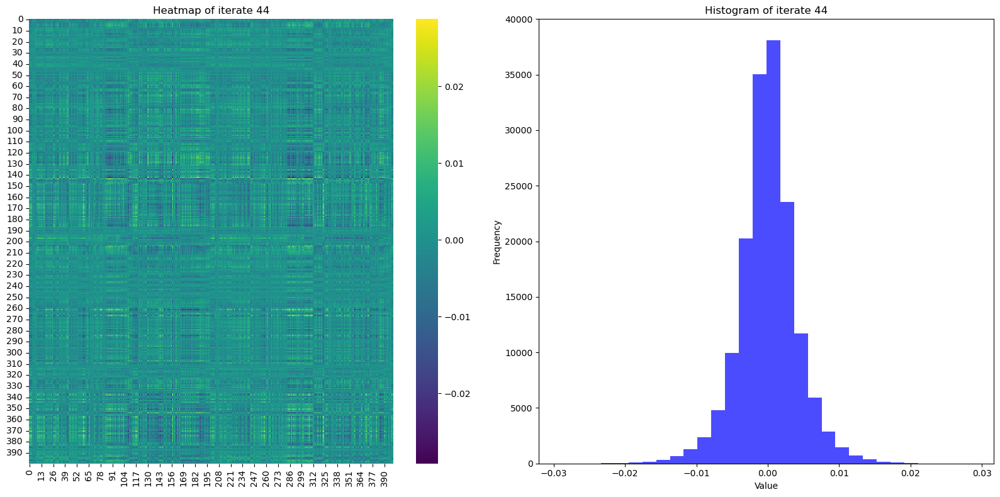

Energy of iterate 44: 1.5998984406260088


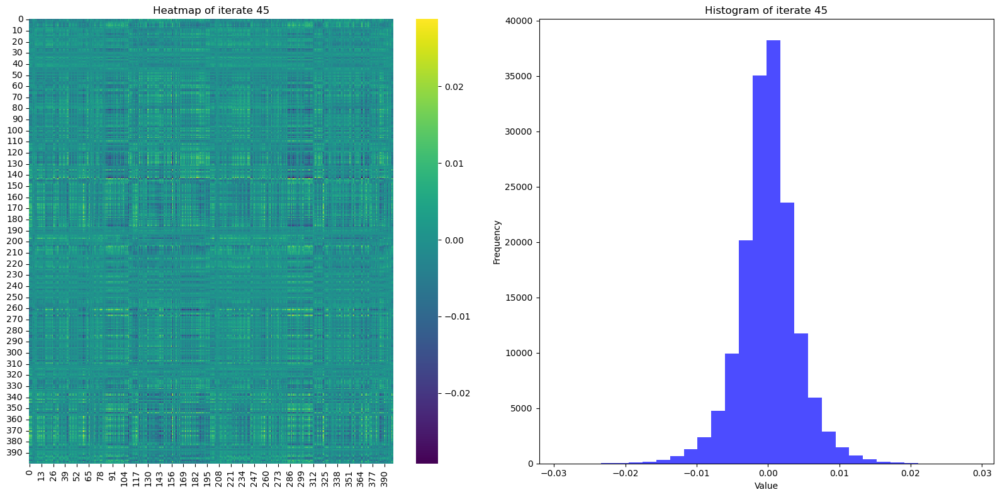

Energy of iterate 45: 1.6061406338200923


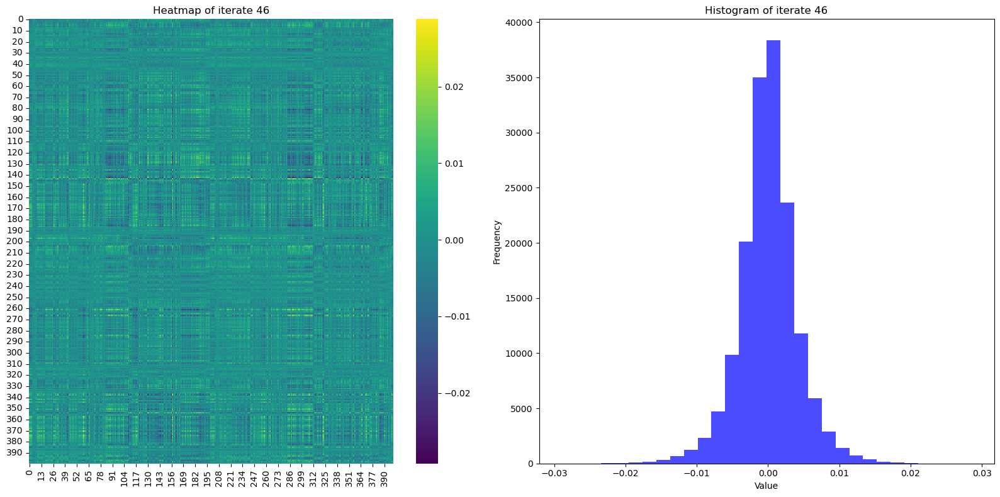

Energy of iterate 46: 1.611830778508074


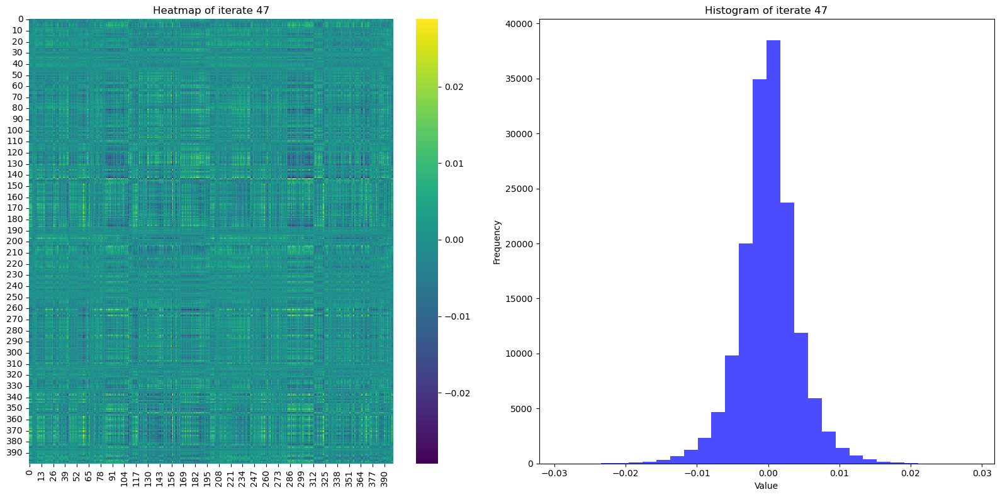

Energy of iterate 47: 1.6169901501225883


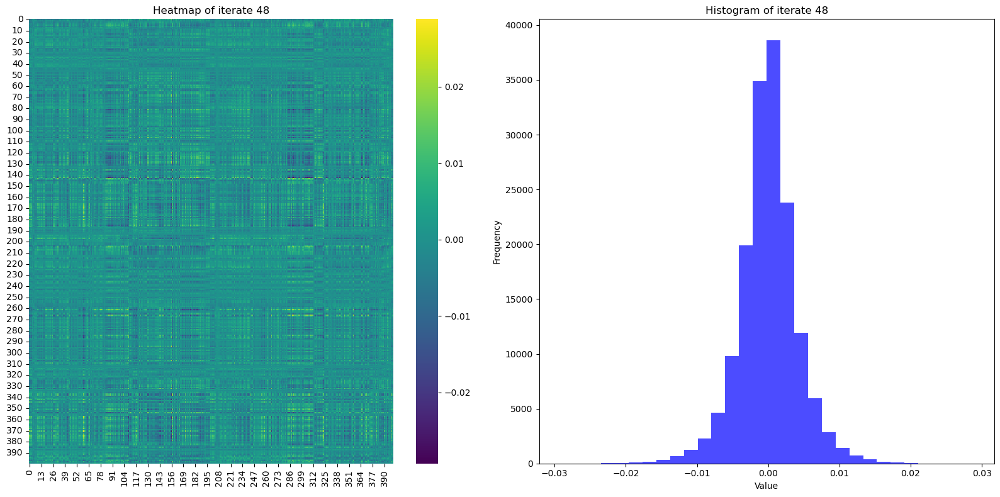

Energy of iterate 48: 1.6216401493224364


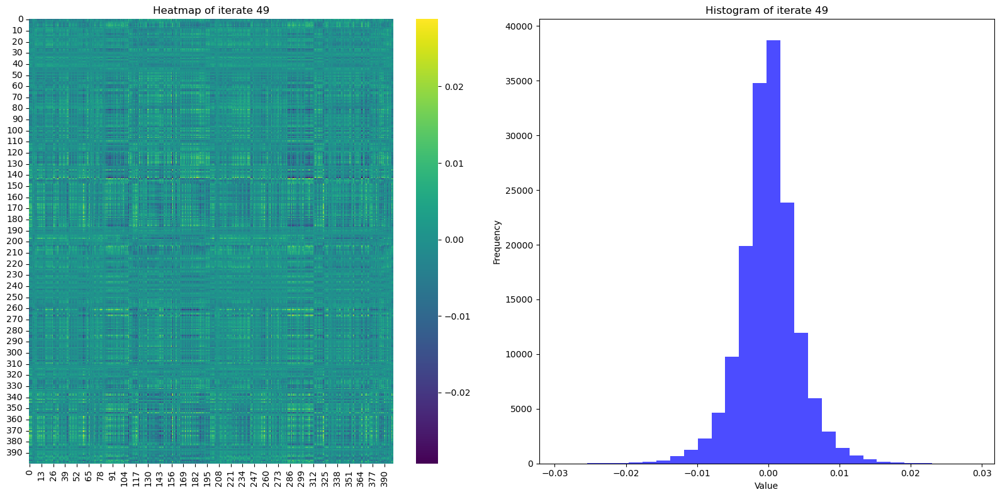

Energy of iterate 49: 1.6258023196175087


In [10]:
## Looking at the factor matrices
separation_rank = 2
tucker_ranks = [4,4]
max_iter = 50

for i in range(max_iter):
    # Get the matrix
    iterate = iterate_level_values[separation_rank-1][len(tucker_ranks)][i]
    
    # Create a figure with 2 subplots: one for the heatmap and one for the histogram
    fig, ax = plt.subplots(1, 2, figsize=(16, 8))
    
    # Plot the heatmap on the first subplot
    sns.heatmap(iterate, cmap='viridis', cbar=True, ax=ax[0])
    ax[0].set_title(f'Heatmap of iterate {i}')
    
    # Plot the histogram on the second subplot
    ax[1].hist(iterate.flatten(), bins=30, color='blue', alpha=0.7)
    ax[1].set_title(f'Histogram of iterate {i}')
    ax[1].set_xlabel('Value')
    ax[1].set_ylabel('Frequency')
    
    # Show the plot
    plt.tight_layout()
    plt.show()
    
    # Calculate the energy of the matrix
    eigen_values = np.linalg.eigvals(iterate)
    energy = np.sum(np.abs(eigen_values)) 
    
    print(f'Energy of iterate {i}:', energy)

    